In [15]:
from pathlib import Path
import os

from astropy.nddata import CCDData
from astropy.visualization import hist
from astropy.stats import mad_std

import ccdproc as ccdp
import matplotlib.pyplot as plt
import numpy as np
import sys
from astropy import units as u


sys.path.append("/home/idies/workspace/Storage/madisonleblanc/persistent/hrpo-pipeline")
import fpnfix
from aperturePhot import showimage as show_image

from astropy.io import fits
from astropy.wcs import WCS
from astropy.coordinates import SkyCoord
import aperturePhot as ap

In [16]:
path = "/home/idies/workspace/Storage/madisonleblanc/persistent/reductions_ASTR4261/"
day = "20211101"
path_day = os.path.join(path, day)

data_red = Path(path_day, "Reduced_Images")
data_red.mkdir(exist_ok = True)

In [17]:
files = ccdp.ImageFileCollection(path_day)
files.summary['file', 'imagetyp', 'filter', 'exptime', 'naxis1', 'naxis2']

file,imagetyp,filter,exptime,naxis1,naxis2
str17,str11,object,float64,int64,int64
Bias-001.fit,Bias Frame,--,0.0,1024,1024
Bias-002.fit,Bias Frame,--,0.0,1024,1024
Bias-003.fit,Bias Frame,--,0.0,1024,1024
Bias-004.fit,Bias Frame,--,0.0,1024,1024
Bias-005.fit,Bias Frame,--,0.0,1024,1024
Bias-006.fit,Bias Frame,--,0.0,1024,1024
Bias-007.fit,Bias Frame,--,0.0,1024,1024
Bias-008.fit,Bias Frame,--,0.0,1024,1024
Bias-009.fit,Bias Frame,--,0.0,1024,1024


In [18]:
calibrated_biases = files.files_filtered(imagetyp='Bias Frame', include_path=True)

combined_bias = ccdp.combine(calibrated_biases,
                             method='median',
                             sigma_clip=True, sigma_clip_low_thresh=5, sigma_clip_high_thresh=5,
                             sigma_clip_func=np.ma.median, sigma_clip_dev_func=mad_std, unit = "adu")

combined_bias.meta['combined'] = True

combined_bias.write(os.path.join(data_red / 'combined_bias.fit'), overwrite = True)

In [19]:
calibrated_darks = files.files_filtered(imagetyp='Dark Frame', include_path=True)
reduced_darks= []
exptime= []

for frame in calibrated_darks:
    image = ccdp.CCDData.read(frame, unit = 'adu')
    exptime.append(image.header["exposure"])
    reduced_darks.append(ccdp.subtract_bias(image, combined_bias))
    
combined_darks = ccdp.combine(reduced_darks,
                             method='median',
                             sigma_clip=True, sigma_clip_low_thresh=5, sigma_clip_high_thresh=5,
                             sigma_clip_func=np.ma.median, sigma_clip_dev_func=mad_std, unit = "adu", scale =1 / np.array(exptime))

combined_darks.header["exposure"] = 1
combined_darks.header['exptime'] = 1

combined_darks.meta['combined'] = True

combined_darks.write(os.path.join(data_red / 'combined_darks.fit'), overwrite = True)

In [20]:
flat_imagetyp = 'Flat Field'

flat_filters = set(h['filter'] for h in files.headers(imagetyp=flat_imagetyp))
flat_filters

{'Bessel B', 'Bessel R', 'Bessel V'}

In [21]:
scale = lambda a: 1/np.median(a)

master_flats = {}

for filt in flat_filters:
    reduced_flats = []
    calibrated_flats = files.files_filtered(imagetyp = flat_imagetyp, filter = filt, include_path=True)
    
    for flat in calibrated_flats:
        image = ccdp.CCDData.read(flat, unit = "adu")
        image = ccdp.subtract_bias(image, combined_bias)
        image = ccdp.subtract_dark(image, combined_darks, scale=True, exposure_unit=u.s, exposure_time = "exptime")
        #image = fpnfix.subtract_fpn(image,combfpn[60],mesh_size=32, verbose = 2)
        reduced_flats.append(image)
    
    combined_flats = ccdp.combine(reduced_flats,
                                 method='median',
                                 sigma_clip=True, sigma_clip_low_thresh=5, sigma_clip_high_thresh=5,
                                 sigma_clip_func=np.ma.median, signma_clip_dev_func=mad_std, unit = "adu", scale = scale
                                )

    master_flats[filt]=combined_flats.copy()

    combined_flats.write(data_red / (filt.replace("","_")+"_combined_flats.fit"), overwrite = True)

2280.4026827812195 5.1891
2263.5 2298.0


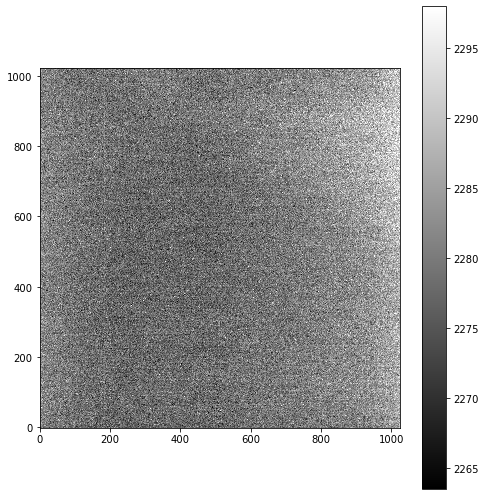

In [22]:
show_image(combined_bias)

5.114559642473854 1.82854
1.4166666666666665 15.013719263766745


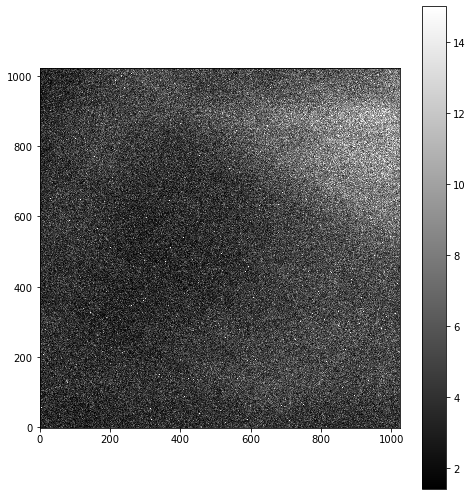

In [23]:
show_image(combined_darks)

0.999244168089053 0.00790011114502437
0.9521636226068946 1.024269577003098


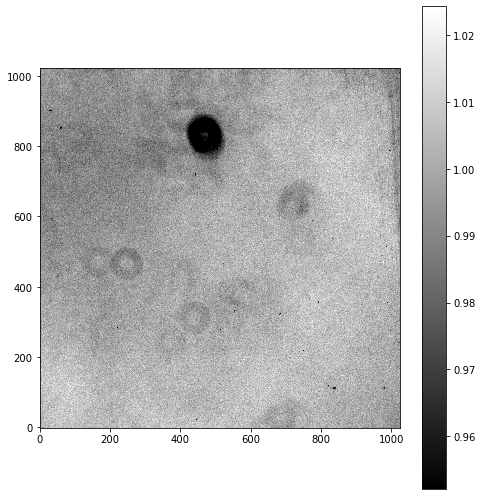

1.0001735469937043 0.01239592142729634
0.9285787275651011 1.0346001168708243


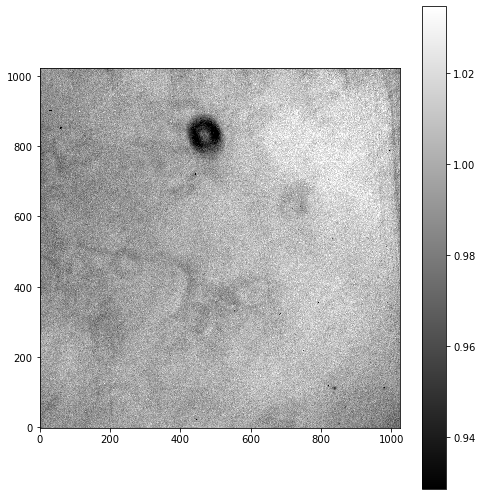

0.9995529313245626 0.009098434456231194
0.9458639298010602 1.0360225701634942


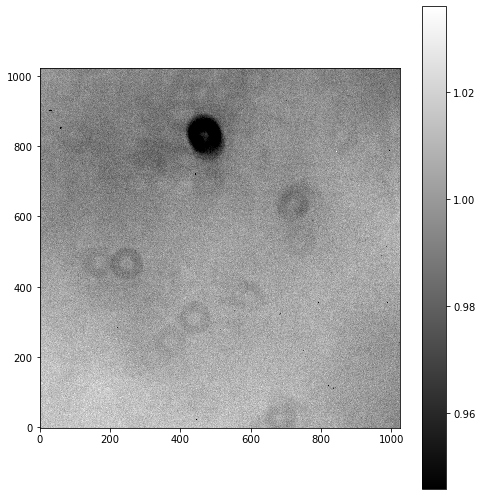

In [24]:
for filt,image in master_flats.items():
    show_image(image)

In [25]:
import ccdproc
images = files.files_filtered(imagetyp="Light Frame", include_path = True)

for image in images:
    var = ccdp.CCDData.read(image, unit = "adu")
    var_filt = var.header["filter"]
    
    corr_filt = master_flats[var_filt]
    
    var = ccdproc.ccd_process(var,
                             master_bias = combined_bias, dark_frame = combined_darks,
                             master_flat = corr_filt, exposure_key="exposure", exposure_unit = u.second,
                             dark_scale = True)
    proc_data = os.path.basename(image)
    var.write(data_red / ("BDF_"+proc_data), overwrite = True)

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
942.0435178227788 141.70591890623314
480.4110419824329 1353.6566434111273


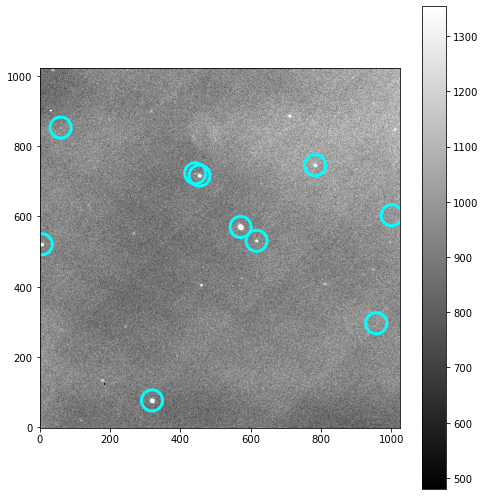

     xcentroid   ycentroid       mag
4   571.105560  570.252674 -2.742726
0   319.138169   76.694659 -1.728980
9    59.032379  852.993749 -0.620227
6   454.227322  716.390254 -0.608004
2     5.520298  521.025916 -0.542402
8   783.179302  745.733916 -0.483357
7   441.999163  723.021756 -0.062238
1   957.215821  296.163824 -0.040332
3   616.379701  530.837249 -0.005453
5  1000.868718  603.631205 -0.003408
Point RA 23 41 55
Point Dec +44 10 46
objcoord <SkyCoord (ICRS): (ra, dec) in deg
    (355.47916667, 44.17944444)>
radecstr 355.479 44.1794
Search radius = 0.13106342470013851 deg
        ra                dec         phot_bp_mean_mag
       deg                deg               mag       
------------------ ------------------ ----------------
 355.5019035183828 44.198035374175014        10.688043
355.45682608764184   44.1091497298546        10.973479
355.64099415478967  44.12772121179612        11.496982
 355.3306982581766   44.2359279272418        11.909237
355.50456763922585  44.06754

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


Return code: 0 


dxfit [4.62194460e+02 1.61582151e+00 1.99411236e-01]
dyfit [ 4.73659552e+02 -1.99755563e-01  1.61493550e+00]

scalex, scaley: 0.614220489628618 0.6145364608378556
anglex, angley: -7.035394540517496 -7.051248155422089
fracdiffs: 0.002253408080142474 0.0005144263575913951

# Created by grmatch 0.9e0 (fi: 0.9.4)
# Invoked command: /home/idies/workspace/Storage/madisonleblanc/persistent/bin/grmatch -r /home/idies/workspace/Storage/madisonleblanc/persistent/reductions_ASTR4261/20211101/Reduced_Images/BDF_HHAnd-001B.gaia.proj -i /home/idies/workspace/Storage/madisonleblanc/persistent/reductions_ASTR4261/20211101/Reduced_Images/BDF_HHAnd-001B.stars.csv -o /home/idies/workspace/Storage/madisonleblanc/persistent/reductions_ASTR4261/20211101/Reduced_Images/BDF_HHAnd-001B.match.csv --match-points --col-ref 4,5 --col-inp 2,3 --output-transformation /home/idies/workspace/Storage/madisonleblanc/persistent/reductions_ASTR4261/20211101/Reduced_Images/BDF_HHAnd-001B.match.transform --

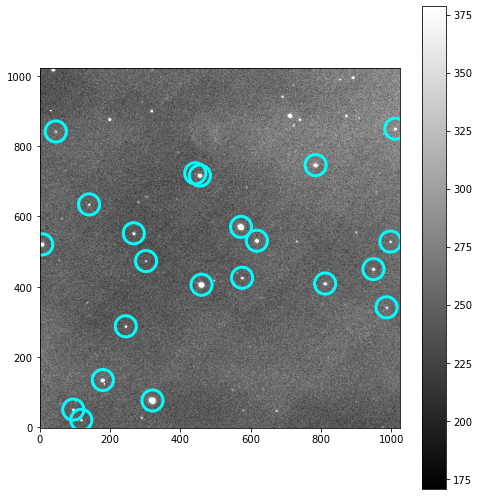

      xcentroid   ycentroid       mag
2    320.405412   76.619160 -4.568468
15   572.309796  570.251512 -4.172077
6    459.916558  405.789261 -3.996067
11     6.610277  520.756220 -2.372428
17   455.355877  716.521020 -2.216104
13   617.391461  531.037932 -2.185461
19   784.572163  746.029440 -2.169818
3    179.104333  134.812386 -1.960455
7    811.724893  409.173208 -1.598740
9    949.045540  450.265504 -1.458463
14   267.188297  552.180838 -0.960145
1     94.996309   50.583114 -0.877342
0    117.784556   21.190169 -0.850406
8    575.318767  425.614313 -0.835607
21  1011.004213  849.680473 -0.814549
4    244.462701  287.628272 -0.655236
16   140.015170  634.370908 -0.584052
10   302.061116  473.273803 -0.494435
12   997.208335  528.648549 -0.484360
5    986.435369  341.528389 -0.413117
18   442.061406  722.981230 -0.398146
20    45.348236  841.865248 -0.177241
Point RA 23 41 55
Point Dec +44 10 46
objcoord <SkyCoord (ICRS): (ra, dec) in deg
    (355.47916667, 44.17944444)>
radecstr 35

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


Return code: 0 


dxfit [4.63394853e+02 1.61606426e+00 1.99132497e-01]
dyfit [ 4.73649526e+02 -1.98910080e-01  1.61507065e+00]

scalex, scaley: 0.6141424748388945 0.6145249198192994
anglex, angley: -7.0246139446952265 -7.021119999000654
fracdiffs: 0.0004973861513358662 0.0006227300603254569

# Created by grmatch 0.9e0 (fi: 0.9.4)
# Invoked command: /home/idies/workspace/Storage/madisonleblanc/persistent/bin/grmatch -r /home/idies/workspace/Storage/madisonleblanc/persistent/reductions_ASTR4261/20211101/Reduced_Images/BDF_HHAnd-001R.gaia.proj -i /home/idies/workspace/Storage/madisonleblanc/persistent/reductions_ASTR4261/20211101/Reduced_Images/BDF_HHAnd-001R.stars.csv -o /home/idies/workspace/Storage/madisonleblanc/persistent/reductions_ASTR4261/20211101/Reduced_Images/BDF_HHAnd-001R.match.csv --match-points --col-ref 4,5 --col-inp 2,3 --output-transformation /home/idies/workspace/Storage/madisonleblanc/persistent/reductions_ASTR4261/20211101/Reduced_Images/BDF_HHAnd-001R.match.transform

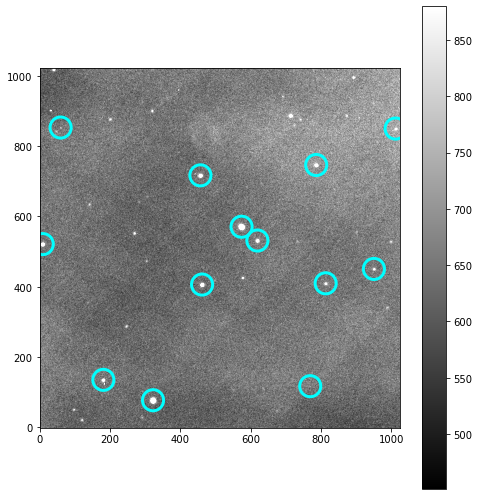

      xcentroid   ycentroid       mag
8    573.820597  570.845482 -3.190607
0    321.959747   77.245239 -2.968726
3    461.473961  406.330920 -1.403715
6      8.179076  521.460231 -1.229569
9    456.747326  717.075890 -1.212435
10   786.189420  746.473055 -0.952891
7    618.867792  531.646797 -0.857435
12    59.048633  853.069392 -0.668892
2    180.612201  135.251325 -0.301545
4    813.100434  409.862267 -0.246928
11  1012.148703  850.143001 -0.201453
1    769.201462  117.191749 -0.087173
5    950.445740  450.769384 -0.003911
Point RA 23 41 55
Point Dec +44 10 46
objcoord <SkyCoord (ICRS): (ra, dec) in deg
    (355.47916667, 44.17944444)>
radecstr 355.479 44.1794
Search radius = 0.13106342470013851 deg
        ra                dec         phot_g_mean_mag
       deg                deg               mag      
------------------ ------------------ ---------------
355.45682608764184   44.1091497298546        10.34314
355.47999369869643 44.170596761287726       10.365541
 355.5019035183828

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
911.3152853134533 136.95855907281202
573.5987815085325 1377.0123295663157


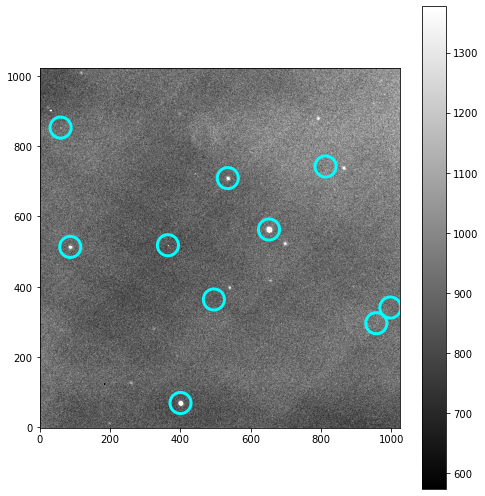

    xcentroid   ycentroid       mag
6  651.860017  563.052691 -2.266767
0  400.080024   69.339127 -1.339094
5  364.328973  518.229185 -0.932551
9   58.997529  852.963253 -0.617015
7  534.640031  709.211678 -0.527404
4   86.412735  513.456823 -0.231781
8  812.872938  742.363524 -0.099167
2  997.102046  340.979839 -0.067629
3  495.181804  363.853820 -0.044104
1  957.204862  296.340943 -0.004616
Point RA 23 41 50
Point Dec +44 10 46
objcoord <SkyCoord (ICRS): (ra, dec) in deg
    (355.45833333, 44.17944444)>
radecstr 355.458 44.1794
Search radius = 0.13106342470013851 deg


/home/idies/workspace/Storage/madisonleblanc/persistent/hrpo-pipeline/plateSolve.py:298: RuntimeWarning: divide by zero encountered in double_scalars
  scalex = 1.0/(dxfit[1]/np.cos(anglex))
/home/idies/workspace/Storage/madisonleblanc/persistent/hrpo-pipeline/plateSolve.py:299: RuntimeWarning: divide by zero encountered in double_scalars
  scaley = 1.0/(dyfit[2]/np.cos(angley))
/home/idies/workspace/Storage/madisonleblanc/persistent/hrpo-pipeline/plateSolve.py:301: RuntimeWarning: invalid value encountered in double_scalars
  fracanglediff = np.abs((anglex - angley)/anglex)
/home/idies/workspace/Storage/madisonleblanc/persistent/hrpo-pipeline/plateSolve.py:302: RuntimeWarning: invalid value encountered in double_scalars
  fracscalediff = np.abs((scalex-scaley)/scalex)
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


        ra                dec         phot_bp_mean_mag
       deg                deg               mag       
------------------ ------------------ ----------------
 355.5019035183828 44.198035374175014        10.688043
355.45682608764184   44.1091497298546        10.973479
 355.3306982581766   44.2359279272418        11.909237
355.50456763922585  44.06754318511075        12.128365
355.47999369869643 44.170596761287726        12.559549
355.47001979053437  44.22036113755551        12.621736
 355.3698096839802  44.17781222041276        12.638292
 355.5469803797695  44.23222573087555        13.010126
 355.5136833365018 44.192329310844094        13.069663
355.52571998929113  44.25459544396694        13.205368
 355.2954907082847  44.21625211177734        13.455604
355.34150523232074 44.149817243497516         13.58919
 355.4217894072697  44.11604778557108        13.625631
 355.3624371923208  44.26267631796206        13.718818
355.49205599770977 44.293673702845524        13.933575
355.505646

253.71070421076996 30.75558061439665
149.20770626969548 378.05625789095376


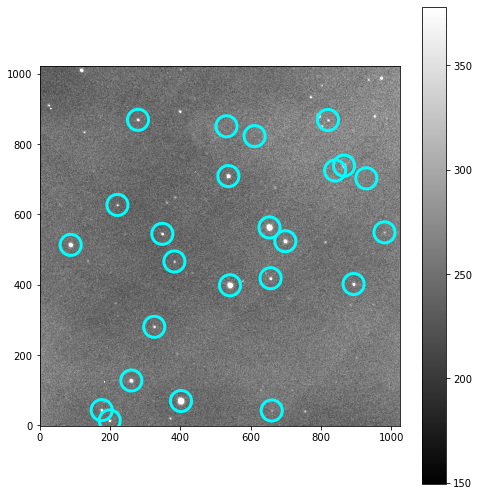

     xcentroid   ycentroid       mag
3   401.540060   69.337222 -4.435479
14  653.252656  563.110430 -4.166584
6   540.954861  398.614552 -3.761928
10   87.638512  513.516805 -2.323360
17  536.301559  709.272804 -2.187425
11  698.359059  523.955846 -2.072349
19  865.456181  738.960901 -2.041606
4   260.173878  127.617571 -1.844033
7   892.600664  402.129588 -1.302373
2   176.050199   43.414854 -0.934656
22  279.209798  869.264867 -0.931992
12  348.389948  544.872197 -0.889097
8   656.389574  418.641169 -0.709349
0   198.683432   13.933658 -0.673403
5   325.417574  280.404262 -0.376235
15  220.774942  627.211281 -0.257200
9   382.785047  466.265553 -0.193499
16  928.769590  702.884375 -0.086475
1   659.673902   42.340474 -0.070834
23  819.848329  868.823932 -0.063583
20  610.935814  822.928722 -0.045990
18  840.005962  725.063574 -0.028941
13  980.478411  549.179917 -0.003021
21  531.023785  850.903928 -0.000497
Point RA 23 41 50
Point Dec +44 10 46
objcoord <SkyCoord (ICRS): (ra, dec) 

/home/idies/workspace/Storage/madisonleblanc/persistent/hrpo-pipeline/plateSolve.py:298: RuntimeWarning: divide by zero encountered in double_scalars
  scalex = 1.0/(dxfit[1]/np.cos(anglex))
/home/idies/workspace/Storage/madisonleblanc/persistent/hrpo-pipeline/plateSolve.py:299: RuntimeWarning: divide by zero encountered in double_scalars
  scaley = 1.0/(dyfit[2]/np.cos(angley))
/home/idies/workspace/Storage/madisonleblanc/persistent/hrpo-pipeline/plateSolve.py:301: RuntimeWarning: invalid value encountered in double_scalars
  fracanglediff = np.abs((anglex - angley)/anglex)
/home/idies/workspace/Storage/madisonleblanc/persistent/hrpo-pipeline/plateSolve.py:302: RuntimeWarning: invalid value encountered in double_scalars
  fracscalediff = np.abs((scalex-scaley)/scalex)
INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


        ra                dec         phot_g_mean_mag
       deg                deg               mag      
------------------ ------------------ ---------------
355.45682608764184   44.1091497298546        10.34314
355.47999369869643 44.170596761287726       10.365541
 355.5019035183828 44.198035374175014       10.528759
 355.3306982581766   44.2359279272418       11.300747
355.50456763922585  44.06754318511075       11.603616
 355.3698096839802  44.17781222041276       12.348801
355.47001979053437  44.22036113755551       12.442065
355.52571998929113  44.25459544396694       12.642408
 355.5469803797695  44.23222573087555       12.708231
 355.5136833365018 44.192329310844094       12.715372
               ...                ...             ...
355.34559411407037  44.13051842761099      13.7032585
355.32943133886914  44.21949946113691       13.769068
 355.5413980430078   44.0704101181017      13.8390465
 355.5720328787715  44.08194082025348       13.874222
355.43035433548386   44.1886

635.4736662553986 75.59410449730812
401.93865533660505 875.4823206162165


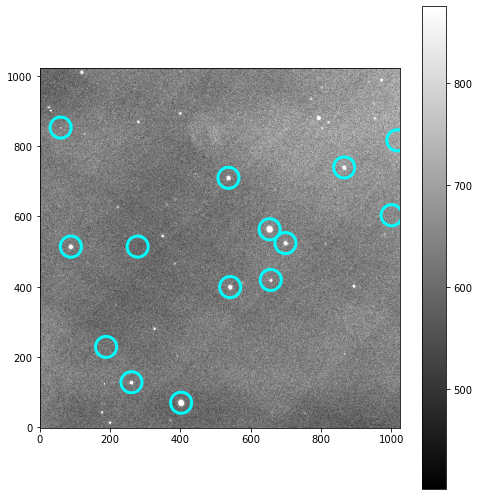

      xcentroid   ycentroid       mag
8    653.547395  563.698418 -3.428971
0    401.859798   70.157501 -3.062668
10   536.546547  709.948437 -1.526061
3    541.292214  399.260273 -1.509809
6     88.082313  514.260489 -1.413078
11   865.775129  739.560853 -1.355174
7    698.583058  524.407281 -1.122437
13    59.011893  853.018733 -0.770949
1    260.640419  128.474798 -0.634271
9   1000.697322  603.652196 -0.072915
5    278.175282  514.324815 -0.066132
12  1017.166228  816.831266 -0.043045
4    656.803465  419.468639 -0.042277
2    188.348119  228.912196 -0.005804
Point RA 23 41 50
Point Dec +44 10 46
objcoord <SkyCoord (ICRS): (ra, dec) in deg
    (355.45833333, 44.17944444)>
radecstr 355.458 44.1794
Search radius = 0.13106342470013851 deg
        ra                dec         phot_g_mean_mag
       deg                deg               mag      
------------------ ------------------ ---------------
355.45682608764184   44.1091497298546        10.34314
355.47999369869643 44.170596761287

In [26]:
import plateSolve
pathlist = Path(data_red).glob('BDF_HHAnd*.fit')

for path in pathlist:
    
    Rimage = ccdp.CCDData.read(path, unit="adu")
    
    check = plateSolve.autoSolve(path,Rimage, verbose = 1)
    if (check == True):
        #print(check)
        print(Rimage.header['JD-HELIO'])
        print("______________________________________________")
        
    else:
        print("!!!!!!!Plate solve did not work for", path)
        print("______________________________________________")
        print(" ")

['id', 'xcentroid', 'ycentroid', 'sharpness', 'roundness1', 'roundness2', 'npix', 'sky', 'peak', 'flux', 'mag']
Star magnitudes at reference aperture radius (39.0):
2 -9.375341423573001
4 -9.09886132197704
5 -8.995224099341804
6 -8.929663039599939
1 -8.665043330778458


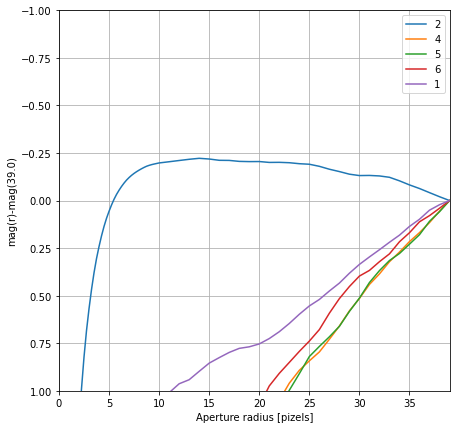

Optimum aperture:
2 6.25
0 5.5
3 5.0
1 5.0
4 39.0
6 39.0
7 2.0
5 39.0


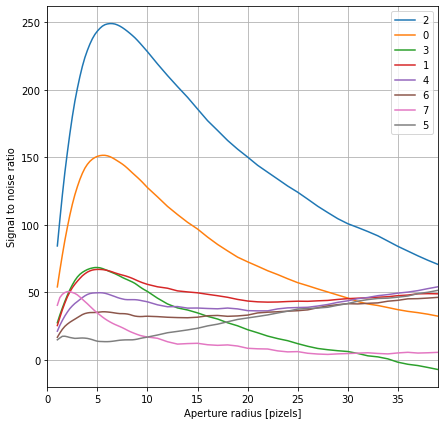

Mean optimum aperture radius = 5.0 from stars [1, 3]
Optimum aperture radius 5.0
stoppingidx 52 26.0
Systematic error from r>stopping aperture
Aperture correction: -0.23649113488971274 +/- 0.053016590725893036
   0  -8.724 +/- 0.006 (stat) 0.053 (sys)
   1  -7.528 +/- 0.014 (stat) 0.053 (sys)
   2  -9.555 +/- 0.004 (stat) 0.053 (sys)
   3  -7.577 +/- 0.013 (stat) 0.053 (sys)
   4  -7.176 +/- 0.019 (stat) 0.053 (sys)
   5  -5.599 +/- 0.067 (stat) 0.053 (sys)
   6  -6.750 +/- 0.026 (stat) 0.053 (sys)
   7  -6.683 +/- 0.027 (stat) 0.053 (sys)
942.0435178227788 141.70591890623314
480.4110419824329 1353.6566434111273
['0', '1', '2', '3', '4', '5', '6', '7']


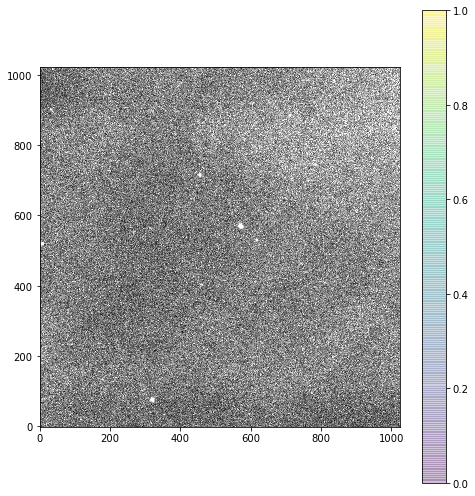

60.0
1.14418666910117


In [28]:
import warnings 

warnings.simplefilter("ignore")
os.chdir(Path(data_red))
#imR = CCDData.read("BDF_HHAnd_0000_002R.wcs.fit", unit = "adu")
imR = fits.open('BDF_HHAnd-001B.wcs.fit')

#Find stars in the image
sources, bgplane= ap.findStars(imR)

#Generate a growth curve (i.e., measure fluxes at a range of aperture 
#sizes for all stars)
rap,mag,err,apers = ap.growthCurve(imR,sources)

#Plot the growth curve - use this to pick stars to use when calculating 
#the aperture correction
ap.plotGrowth(rap,mag,err,figsize=(7,7))
useForAppCorr = [2]
stoppingApertureRadius = 26.0

#Plot the SNR curve for a chosen star(s) and estimate the optimum aperture
ap.plotSNR(rap,mag,err,Nbrightest=9,figsize=(7,7))

#Apply an aperture correction for a chosen optimal aperture radius
imag,ierr,isys,apCorr = ap.apertureCorrection(rap,mag,err,optap=[1,3],
                                              stoppingAperture=stoppingApertureRadius,
                                              stars=useForAppCorr)


for i,m in enumerate(imag):
    print('%4d %7.3f +/- %5.3f (stat) %5.3f (sys)' % (sources['id'][i]-1,m,ierr[i],isys))

imag
ap.showimage(imR[0].data,stars=sources)
print(imR[0].header['EXPOSURE'])
print(imR[0].header["AIRMASS"])

In [15]:
xpix = sources["xcentroid"][3]
ypix = sources["ycentroid"][3]
w = WCS(imR[0].header)
#Rstarxy = np.transpose((sources['xcentroid'],sources['ycentroid']))
#radec = w.all_pix2world(Rstarxy,1)
sky =w.pixel_to_world(xpix,ypix)
print(sky)

<SkyCoord (ICRS): (ra, dec) in deg
    (355.48029056, 44.16788631)>


['id', 'xcentroid', 'ycentroid', 'sharpness', 'roundness1', 'roundness2', 'npix', 'sky', 'peak', 'flux', 'mag']
Star magnitudes at reference aperture radius (4.0):
6 -10.065750518352125
23 -9.66475143256159
12 -9.320104980644087
7 -9.13789576412719
27 -7.772268202132807


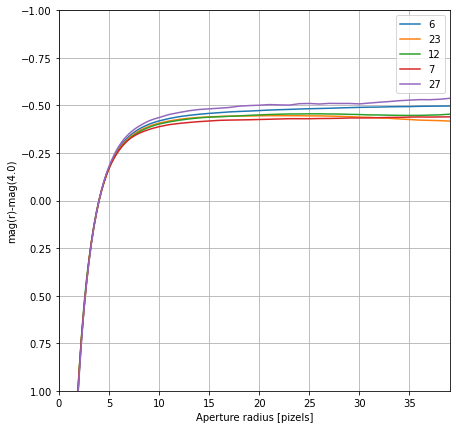

Optimum aperture:
6 7.5
23 7.0
12 6.5
7 6.0
27 5.0
34 5.0
28 4.75
20 4.75
8 4.75


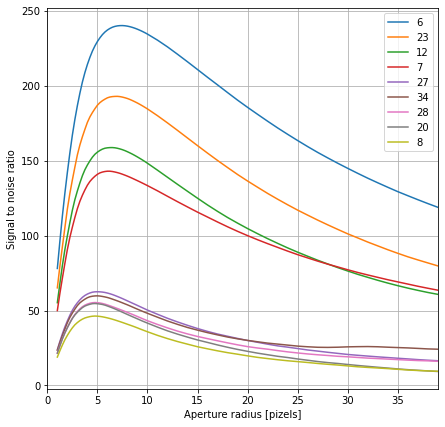

Mean optimum aperture radius = 4.75 from stars [28, 20]
Optimum aperture radius 4.75
stoppingidx 52 26.0
Systematic error from r>stopping aperture
Aperture correction: -0.29680266437208225 +/- 0.0029327863183818987
   0  -5.899 +/- 0.088 (stat) 0.003 (sys)
   1  -6.711 +/- 0.045 (stat) 0.003 (sys)
   2  -6.542 +/- 0.052 (stat) 0.003 (sys)
   3  -5.946 +/- 0.085 (stat) 0.003 (sys)
   4  -5.737 +/- 0.102 (stat) 0.003 (sys)
   5  -6.848 +/- 0.040 (stat) 0.003 (sys)
   6 -10.503 +/- 0.004 (stat) 0.003 (sys)
   7  -9.569 +/- 0.007 (stat) 0.003 (sys)
   8  -7.783 +/- 0.020 (stat) 0.003 (sys)
   9  -6.487 +/- 0.054 (stat) 0.003 (sys)
  10  -5.616 +/- 0.112 (stat) 0.003 (sys)
  11  -5.942 +/- 0.085 (stat) 0.003 (sys)
  12  -9.754 +/- 0.006 (stat) 0.003 (sys)
  13  -7.342 +/- 0.027 (stat) 0.003 (sys)
  14  -5.459 +/- 0.129 (stat) 0.003 (sys)
  15  -6.847 +/- 0.040 (stat) 0.003 (sys)
  16  -7.112 +/- 0.032 (stat) 0.003 (sys)
  17  -5.993 +/- 0.081 (stat) 0.003 (sys)
  18  -6.174 +/- 0.069 (stat)

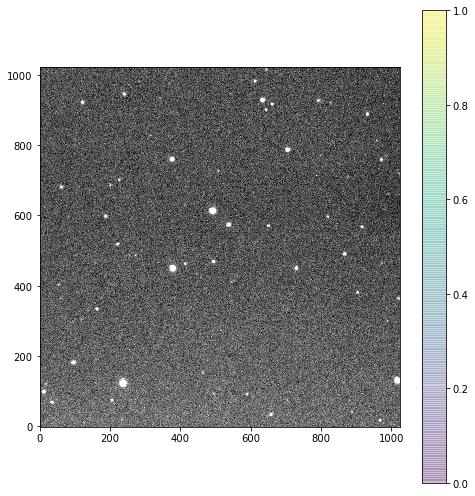

20.0
1.03058225871322


In [17]:
os.chdir(Path(data_red))
#imR = CCDData.read("BDF_HHAnd_0000_002R.wcs.fit", unit = "adu")
imR = fits.open('BDF_HH_And-001R.wcs.fit')

#Find stars in the image
sources, bgplane= ap.findStars(imR)

#Generate a growth curve (i.e., measure fluxes at a range of aperture 
#sizes for all stars)
rap,mag,err,apers = ap.growthCurve(imR,sources)

#Plot the growth curve - use this to pick stars to use when calculating 
#the aperture correction
ap.plotGrowth(rap,mag,err,figsize=(7,7))
useForAppCorr = [7]
stoppingApertureRadius = 26.0

#Plot the SNR curve for a chosen star(s) and estimate the optimum aperture
ap.plotSNR(rap,mag,err,Nbrightest=9,figsize=(7,7))

#Apply an aperture correction for a chosen optimal aperture radius
imag,ierr,isys,apCorr = ap.apertureCorrection(rap,mag,err,optap=[28,20],
                                              stoppingAperture=stoppingApertureRadius,
                                              stars=useForAppCorr)

for i,m in enumerate(imag):
    print('%4d %7.3f +/- %5.3f (stat) %5.3f (sys)' % (sources['id'][i]-1,m,ierr[i],isys))

imag
ap.showimage(imR[0].data,stars=sources)
print(imR[0].header['EXPOSURE'])
print(imR[0].header["AIRMASS"])

In [18]:
xpix = sources["xcentroid"][12]
ypix = sources["ycentroid"][12]
w = WCS(imR[0].header)
#Rstarxy = np.transpose((sources['xcentroid'],sources['ycentroid']))
#radec = w.all_pix2world(Rstarxy,1)
sky =w.pixel_to_world(xpix,ypix)
print(sky)

<SkyCoord (ICRS): (ra, dec) in deg
    (355.48027454, 44.16789831)>
